In [1]:
import os
import sys
os.chdir('/ictstr01/home/icb/fatemehs.hashemig/codes/interpretable-ssl')

# imports

In [2]:
import interpretable_ssl.datasets.dataset
import interpretable_ssl.trainers.base
import experiment_evaluator

INFO:pytorch_lightning.utilities.seed:Global seed set to 0
/home/icb/fatemehs.hashemig/miniconda3/envs/apex-env/lib/python3.12/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/icb/fatemehs.hashemig/miniconda3/envs/apex-env/lib/python3.12/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)
 captum (see https://github.com/pytorch/captum).


In [3]:
import interpretable_ssl.configs.defaults

import interpretable_ssl.trainers.base
import interpretable_ssl.trainers.trainer
import interpretable_ssl.trainers.scpoli_trainer

import interpretable_ssl.trainers.adaptive_trainer
import interpretable_ssl.trainers.scpoli_original

import interpretable_ssl.trainers.swav

# reloads

In [4]:
import importlib

In [5]:
import importlib
import interpretable_ssl.utils
importlib.reload(interpretable_ssl.utils)

import interpretable_ssl.datasets.dataset
importlib.reload(interpretable_ssl.datasets.dataset)

import interpretable_ssl.configs.defaults
importlib.reload(interpretable_ssl.configs.defaults)

import interpretable_ssl.trainers.swav
importlib.reload(interpretable_ssl.trainers.swav)

importlib.reload(interpretable_ssl.configs.defaults)

# Reloading the modules in the same order
import interpretable_ssl.trainers.base
importlib.reload(interpretable_ssl.trainers.base)

import interpretable_ssl.trainers.trainer
importlib.reload(interpretable_ssl.trainers.trainer)

import interpretable_ssl.trainers.scpoli_trainer
importlib.reload(interpretable_ssl.trainers.scpoli_trainer)

import interpretable_ssl.trainers.adaptive_trainer
importlib.reload(interpretable_ssl.trainers.adaptive_trainer)

import interpretable_ssl.trainers.scpoli_original
importlib.reload(interpretable_ssl.trainers.scpoli_original)

import interpretable_ssl.trainers.swav
importlib.reload(interpretable_ssl.trainers.swav)


<module 'interpretable_ssl.trainers.swav' from '/ictstr01/home/icb/fatemehs.hashemig/codes/interpretable-ssl/interpretable_ssl/trainers/swav.py'>

In [6]:
importlib.reload(interpretable_ssl.datasets.dataset)
importlib.reload(interpretable_ssl.trainers.base)
importlib.reload(experiment_evaluator)
importlib.reload(interpretable_ssl.trainers.base)
importlib.reload(interpretable_ssl.trainers.swav)

<module 'interpretable_ssl.trainers.swav' from '/ictstr01/home/icb/fatemehs.hashemig/codes/interpretable-ssl/interpretable_ssl/trainers/swav.py'>

# imports (II)

In [7]:
from experiment_evaluator import *


In [8]:
from interpretable_ssl.datasets.hlca import *

In [225]:
def filter_trainers(inp_trainers):
    def model_exist(trainer):
        if os.path.exists(trainer.get_model_path()):
            return True
        return False
    return [trainer for trainer in inp_trainers if model_exist(trainer)]

# prepare trainers

In [55]:
item_to_test = {
        'swav': {
            "dimensionality_reduction": ["pca", None],
            "prot_decoding_loss_scaler": [0, 5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "k_neighbors": [7],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["knn", 'community'],
            'batch_size': [1024, 512],
            'dataset_id':['hlca'],
            'model_name_version': [3.5, 3],
            "nmb_crops": [[3]]
        },
        'scpoli': {
            'latent_dims': [8],
            'batch_size': [1024, 512],
            'experiment_name': ['scpoli'],
            'dataset_id':['hlca'],
            
            'model_name_version': [3.5]
        }
    }

In [56]:
importlib.reload(interpretable_ssl.datasets.hlca)

<module 'interpretable_ssl.datasets.hlca' from '/ictstr01/home/icb/fatemehs.hashemig/codes/interpretable-ssl/interpretable_ssl/datasets/hlca.py'>

In [57]:
from interpretable_ssl.datasets.immune import *
from interpretable_ssl.datasets.hlca import *

# ds = HLCADataset()

In [58]:
evaluator = ExperimentEvaluator(ds)
trainers = evaluator.generate_trainers(item_to_test)

INFO:root:Starting '__init__' of class 'get train test'
INFO:root:Finished '__init__' of class 'get train test' in 3.4706 seconds
Generating trainers for scpoli: 100%|██████████| 2/2 [00:00<00:00, 614.24it/s, Memory=19.6%, CPU=0.0%, trainer_name=scpoli_BS_512_exp_scpoli_ds_hlca]


In [59]:
for trainer in trainers:
    if trainer.name[-4:] == 'scpo':
        trainer.name = trainer.name[-4:] + trainer.experiment_name


nb_trainer = evaluator.generate_trainers({'swav':{
            "prot_decoding_loss_scaler": [0, 5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["nb"],
            'batch_size': [1024, 512],
            'model_name_version': [3.5, 3],
            'dataset_id': ['hlca'],
    "nmb_crops": [[3]]
        }})


for trainer in trainers:
    trainer.finetuning = True

Generating trainers for swav: 100%|██████████| 16/16 [00:00<00:00, 653.48it/s, Memory=19.6%, CPU=0.0%, trainer_name=swav_aug_nb_PDLS_5_cvaeLS_0.0001_BS_512_ds_hlca]


In [60]:
for trainer in nb_trainer:
    trainer.finetuning = True
    trainers.append(trainer)

# immune results with metric generator

In [65]:
from interpretable_ssl.datasets.immune import *
ids = ImmuneDataset()

loading pbmc-immune data
done


In [87]:
td = {
        'swav': {
            "dimensionality_reduction": ["pca", None],
            "prot_decoding_loss_scaler": [5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "k_neighbors": [7],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["knn", 'community'],
            'batch_size': [1024, 512],
            # 'dataset_id':['hlca'],
            'model_name_version': [3.5, 3],
            'num_prototypes': [16, 300]
            
        },
        'scpoli': {
            'latent_dims': [8],
            'batch_size': [1024, 512],
            'experiment_name': ['scpoli-semi'],
            # 'dataset_id':['hlca'],
            'model_name_version': [3.5]
        }
    }

nb_td = {'swav':{
            "prot_decoding_loss_scaler": [5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["nb"],
            'batch_size': [1024, 512],
            'model_name_version': [3.5, 3],
            'num_prototypes': [16, 300]
        }}

ee = ExperimentEvaluator(ids)
ee.evaluate_results([nb_td, td])

INFO:root:Starting '__init__' of class 'get train test'
INFO:root:Finished '__init__' of class 'get train test' in 0.2777 seconds
Generating trainers for scpoli: 100%|██████████| 2/2 [00:00<00:00, 606.64it/s, Memory=13.1%, CPU=4.8%, trainer_name=scpoli_bs_512_exp_scpoli-semi]


all trainers: 82, valid trainers: 32
metric generator for  swav_aug_nb_PDLS_5
metric generator for  swav_aug_nb_PDLS_5
metric generator for  swav_aug_nb_PDLS_5_cvaeLS_0.0001
metric generator for  swav_aug_nb_PDLS_5_cvaeLS_0.0001
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7_NP_16
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7_NP_16
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7_NP_16
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7_NP_16
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_NP_16
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_NP_16
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7
metric generator for  swav_

,scib total,knn f1 macro,knn f1 micro,knn f1 weighted,linear classifier f1 macro,linear classifier f1 micro,linear classifier f1 weighted,Rank-PCA,Corr-PCA,Corr-Weighted
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.631,0.794,0.664,0.769,0.713,0.409,0.609,0.496,0.541,0.466
scpoli_exp_scpoli-semi,0.626,0.778,0.735,0.756,0.571,0.292,0.452,0.527,0.563,0.378


In [88]:
for trainer in ee.trainers:
    if trainer.name =='swav_aug_knn_DR_pca_PDLS_5_kN_7':
        
        img_path = trainer.get_dump_path()
img_path = os.path.join(img_path, 'query-umap.png')


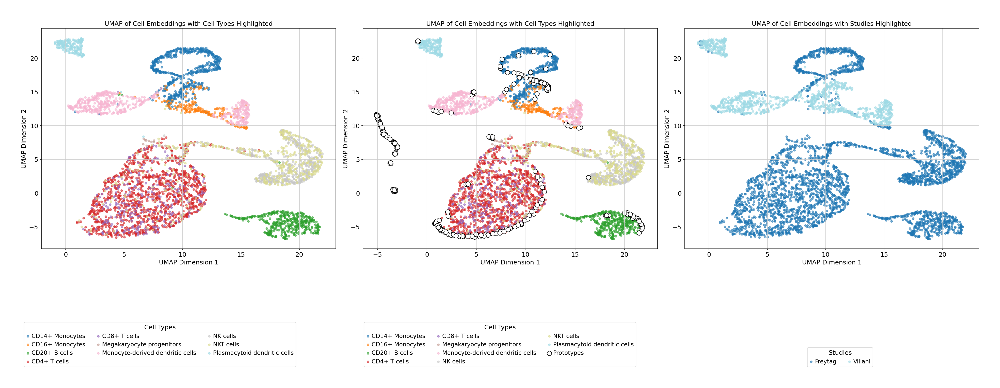

In [89]:
from PIL import Image
import matplotlib.pyplot as plt

img = Image.open(img_path)

# Set the figure size to adjust the display size
plt.figure(figsize=(30, 10))  # Adjust the figure size as needed
plt.tight_layout(rect=[0, 0.2, 1, 1])

# Display the image
plt.imshow(img)
plt.axis('off')  # Hide axes for a cleaner display
plt.show()

# hlca result with metrics generator

In [50]:
import interpretable_ssl.evaluation.metric_generator
importlib.reload(interpretable_ssl.evaluation.metric_generator)
from interpretable_ssl.evaluation.metric_generator import *

In [51]:
import interpretable_ssl.trainers.scpoli_original
importlib.reload(interpretable_ssl.trainers.scpoli_original)

import experiment_runner
importlib.reload(experiment_runner)
from experiment_runner import *
import experiment_evaluator
importlib.reload(experiment_evaluator)
from experiment_evaluator import *

In [52]:
# ds = HLCADataset()

In [82]:
td = {
        'swav': {
            "dimensionality_reduction": ["pca", None],
            "prot_decoding_loss_scaler": [5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "k_neighbors": [7],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["knn", 'community'],
            'batch_size': [1024, 512],
            'dataset_id':['hlca'],
            'model_name_version': [3.5, 3],
            'num_prototypes': [50, 300],
            'nmb_crops': [[3]]
            
        },
        'scpoli': {
            'latent_dims': [8],
            'batch_size': [1024, 512],
            'experiment_name': ['scpoli'],
            'dataset_id':['hlca'],
            'model_name_version': [3, 3.5],
            
        }
    }

nb_td = {'swav':{
            "prot_decoding_loss_scaler": [5],
            "cvae_loss_scaler": [0.0, 0.0001],
            "training_type": ['semi_supervised'],
            "fine_tuning_epochs": [150],
            "pretraining_epochs": [150],
            "augmentation_type": ["nb"],
            'batch_size': [1024, 512],
            'model_name_version': [3.5, 3],
            'dataset_id':['hlca'],
            'num_prototypes': [50, 300],
            'nmb_crops': [[3]]
        }}
ee = ExperimentEvaluator(ds)
ee.evaluate_results([nb_td, td])

INFO:root:Starting '__init__' of class 'get train test'
INFO:root:Finished '__init__' of class 'get train test' in 3.3555 seconds
Generating trainers for scpoli: 100%|██████████| 4/4 [00:00<00:00, 730.91it/s, Memory=13.1%, CPU=5.6%, trainer_name=scpoli_bs_512_exp_scpoli_ds_hlca]


all trainers: 84, valid trainers: 22
metric generator for  swav_aug_nb_PDLS_5_ds_hlca_NP_50
metric generator for  swav_aug_nb_PDLS_5_ds_hlca_NP_50
metric generator for  swav_aug_nb_PDLS_5_cvaeLS_0.0001_ds_hlca_NP_50
metric generator for  swav_aug_nb_PDLS_5_cvaeLS_0.0001_ds_hlca_NP_50
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7_bs_512_ds_hlca
metric generator for  swav_aug_knn_DR_pca_PDLS_5_kN_7_bs_512_ds_hlca
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7_ds_hlca
metric generator for  swav_aug_comm_DR_pca_PDLS_5_kN_7_ds_hlca
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_bs_512_ds_hlca
metric generator for  swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_bs_512_ds_hlca
metric generator for  swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_ds_hlca
metric generator for  swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_ds_hlca
metric generator for  swav_aug_knn_PDLS_5_kN_7_ds_hlca_NP_50
metric generator for  swav_aug_knn_PDLS_5_kN_7_ds_hlca_NP_50
metric ge

,scib total,knn f1 macro,knn f1 micro,knn f1 weighted,linear classifier f1 macro,linear classifier f1 micro,linear classifier f1 weighted,Rank-PCA,Corr-PCA,Corr-Weighted
swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_ds_hlca,0.618,0.635,0.309,0.618,0.670,0.299,0.585,0.576,0.765,0.735
swav_aug_comm_DR_pca_PDLS_5_kN_7_ds_hlca,0.600,0.714,0.344,0.702,0.732,0.306,0.666,0.522,0.730,0.724
scpoli_exp_scpoli_ds_hlca,0.568,0.772,0.422,0.764,0.635,0.159,0.558,0.706,0.844,0.863


In [83]:
for trainer in ee.trainers:
    if trainer.name == 'swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_ds_hlca':
        path = trainer.get_dump_path()
path

'/home/icb/fatemehs.hashemig/models//hlca/swav-all-loss_iloss5_closs0.0001_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7'

In [84]:
from IPython.display import Image
from IPython.display import display

# Specify the image file path
image_path = os.path.join(path, 'query-umap.png')


In [85]:
image_path

'/home/icb/fatemehs.hashemig/models//hlca/swav-all-loss_iloss5_closs0.0001_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/query-umap.png'

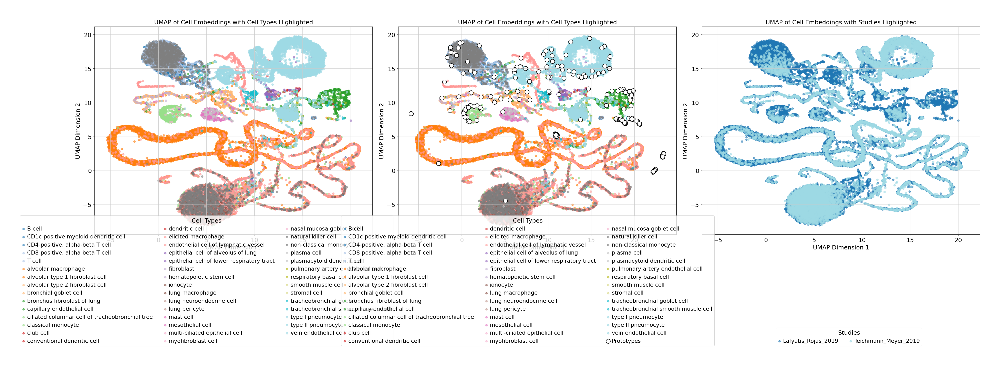

In [86]:
from PIL import Image
import matplotlib.pyplot as plt

img = Image.open(image_path)

# Set the figure size to adjust the display size
plt.figure(figsize=(30, 10))  # Adjust the figure size as needed
plt.tight_layout(rect=[0, 0.2, 1, 1])

# Display the image
plt.imshow(img)
plt.axis('off')  # Hide axes for a cleaner display
plt.show()

In [62]:
import shutil

shutil.copy(image_path, 'notebooks')

'notebooks/query-umap.png'

# test namings

In [157]:
len(trainers)

82

In [158]:
def get_trainers_with_existing_paths(trainers):
    valid_trainers = [trainer for trainer in tqdm(trainers) if trainer.check_scib_metrics_exist()]
    not_exists = [trainer for trainer in trainers if trainer not in valid_trainers]
    for trainer in not_exists:
        print(f'{trainer.get_metric_file_path("ref")} not exist')
    return valid_trainers

v = get_trainers_with_existing_paths(trainers)
len(v)

 23%|██▎       | 19/82 [00:00<00:00, 141.78it/s]

/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-metrics-semi-supervised.csv  exists
/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-scib-semi-supervised.csv  exists
/home/icb/fatemehs.hashemig/models//hlca/swav_iloss0_closs0.0001_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-metrics-semi-supervised.csv  exists
/home/icb/fatemehs.hashemig/models//hlca/swav_iloss0_closs0.0001_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-scib-semi-supervised.csv  exists
/home/icb/fatemehs.hashemig/models//hlca/swav-interpretable_iloss5_closs0.0_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-metric

100%|██████████| 82/82 [00:00<00:00, 302.25it/s]

/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_k_neighbors-7/ref-scib-semi-supervised.csv  exists
/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-metrics-semi-supervised.csv not exist
/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-scib-semi-supervised.csv not exist
/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-metrics-semi-supervised.csv not exist
/home/icb/fatemehs.hashemig/models//hlca/swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7/ref-scib-semi-supervised.

18

In [159]:
v_models = []
for t in v:
    v_models.append(t.get_metric_file_path("ref").split('/')[-2])

In [160]:
len(v_models), len(set(v_models))

(18, 9)

# hlca results

In [161]:
import os
import pandas as pd

def read_and_concat_query_metrics(base_path):
    all_dataframes = []
    all_columns = set()

    # Loop through directories and check for specific files
    for root, _, files in os.walk(base_path):
        # Check if either 'query-metrics-semi-supervised.csv' or 'query-scib-semi-supervised.csv' exists
        target_file = None
        if 'query-metrics-semi-supervised.csv' in files:
            target_file = 'query-metrics-semi-supervised.csv'
        elif 'query-scib-semi-supervised.csv' in files:
            target_file = 'query-scib-semi-supervised.csv'
        
        if target_file:
            # Full path to the target file
            file_path = os.path.join(root, target_file)
            
            # Read the CSV into a DataFrame
            df = pd.read_csv(file_path)
            
            # Rename 'Total' to 'scib_total' if present
            df.rename(columns={'Total': 'scib total'}, inplace=True)
            
            # Add the folder name as the model column
            df['model'] = os.path.basename(root)

            # Update the column set
            all_columns.update(df.columns)
            
            # Append the DataFrame to the list
            all_dataframes.append(df)

    if not all_dataframes:
        print("No relevant query-metrics or query-scib files found.")
        return pd.DataFrame()

    # Ensure all DataFrames have the same columns, filling missing columns with NaN
    all_columns = sorted(all_columns)
    merged_dataframes = [df.reindex(columns=all_columns, fill_value=pd.NA) for df in all_dataframes]
    
    # Concatenate all DataFrames
    result_df = pd.concat(merged_dataframes, ignore_index=True).drop_duplicates()

    # Exclude 'model' column from conversion to numeric
    numeric_columns = result_df.columns.difference(['model'])
    
    # Convert columns that should be numeric and remove rows with invalid string values in numeric columns
    result_df[numeric_columns] = result_df[numeric_columns].apply(pd.to_numeric, errors='coerce')

    # Drop rows where all numeric columns are NaN (invalid rows)
    result_df = result_df.dropna(how='all', subset=numeric_columns)

    return result_df


In [107]:
hlca_path = '/home/icb/fatemehs.hashemig/models/hlca'

res = read_and_concat_query_metrics(hlca_path)

In [109]:
for model in res['model']:
    print(model)

test_num-prot-300_latent8-bs1024-semi_aug-nb3_ep0.02_model-v1
swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_k_neighbors-7
scpoli_latent8_bs512
swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-nb3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
swav-interpretable_iloss5_closs0.0_num-prot-300_latent8-semi_aug-nb3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
scpoli_latent8_bs1024
swav-all-loss_iloss5_closs0.0001_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
test_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7
swav-interpretable_iloss5_closs0.0_num-prot-300_latent8-bs1024-se

In [162]:
vset = set(v_models)
mset = set(res['model'])

In [163]:
len(vset), len(mset)

(9, 15)

In [164]:
mset - vset

{'scpoli_latent8_bs1024',
 'scpoli_latent8_bs512',
 'swav-interpretable_iloss5_closs0.0_num-prot-300_latent8-semi_aug-nb3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7',
 'swav-only_iloss0_closs0.0_num-prot-300_latent8-semi_aug-nb3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7',
 'test_num-prot-300_latent8-bs1024-semi_aug-nb3_ep0.02_model-v1',
 'test_num-prot-300_latent8-semi_aug-knn3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7'}

In [167]:
trainers[-17].get_dump_path()

'/home/icb/fatemehs.hashemig/models//hlca/scpoli-semi_latent8_bs512'

In [165]:
len(nb_trainer)

16

In [83]:
f = res[res['scib total'] >= 0.568368] 

In [88]:
s = f[['model', 'scib total','Corr-PCA', 'Corr-Weighted', 'Rank-PCA', 'Batch correction', 'Bio conservation']].sort_values(by=['scib total'], ascending=False)

In [89]:
s.iloc[0]['model']

'swav-all-loss_iloss5_closs0.0001_num-prot-300_latent8-bs1024-semi_aug-community3_ep0.02_model-v1_dimensionality_reduction-pca_k_neighbors-7'

In [90]:
s

,model,scib total,Corr-PCA,Corr-Weighted,Rank-PCA,Batch correction,Bio conservation
17,swav-all-loss_iloss5_closs0.0001_num-prot-300_...,0.617789,NaN,NaN,NaN,0.577754,0.644479
19,swav_iloss0_closs0.0001_num-prot-300_latent8-b...,0.610089,NaN,NaN,NaN,0.548420,0.651203
6,swav-only_iloss0_closs0.0_num-prot-300_latent8...,0.609918,NaN,NaN,NaN,0.539210,0.657056
2,swav-only_iloss0_closs0.0_num-prot-300_latent8...,0.603442,NaN,NaN,NaN,0.533158,0.650299
12,test_num-prot-300_latent8-semi_aug-knn3_ep0.02...,0.599880,0.820259,0.828404,0.639057,0.480464,0.679490
13,swav-interpretable_iloss5_closs0.0_num-prot-30...,0.599553,NaN,NaN,NaN,0.502103,0.664520
15,swav_iloss0_closs0.0001_num-prot-300_latent8-s...,0.572295,0.647606,0.555549,0.445728,0.439490,0.660832
5,swav-only_iloss0_closs0.0_num-prot-300_latent8...,0.571793,0.672813,0.605687,0.472678,0.473396,0.637391
9,scpoli_latent8_bs1024,0.568368,0.843602,0.863205,0.705971,0.562847,0.572049


# compare results

In [35]:
query = compare_trainers(v, 'query')

# query.sort_values(by='Total', ascending=False)[['Total', 'Batch correction', 'Bio conservation']]  

In [36]:
query

,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
identifier,,,,,,,,,,,,,
swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7_ds_hlca,0.457,0.697,0.532,0.556,0.979,0.629,0.518,0.628,0.409,0.705,0.578,0.644,0.618


In [174]:
scpoli_total = query['Total'].iloc[-1]
query[query['Total'] > scpoli_total].sort_values(by='Total', ascending=False)

,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
identifier,,,,,,,,,,,,,
swav_aug_comm_kN_7,0.635,0.727,0.645,0.657,0.987,0.537,0.0,0.605,0.851,0.677,0.534,0.730,0.652
swav_aug_comm_DR_pca_kN_7,0.616,0.728,0.630,0.645,0.987,0.538,0.0,0.606,0.853,0.700,0.539,0.721,0.649
swav_aug_comm_DR_pca_cvaeLS_0.0001_kN_7,0.624,0.710,0.615,0.617,0.987,0.574,0.0,0.606,0.870,0.710,0.552,0.710,0.647
swav_aug_comm_cvaeLS_0.0001_kN_7,0.601,0.689,0.600,0.636,0.984,0.640,0.0,0.596,0.868,0.690,0.559,0.702,0.645
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.568,0.748,0.655,0.605,0.963,0.617,0.0,0.609,0.749,0.607,0.516,0.708,0.631


# calculate scgraph results

In [22]:
latents = [encode(trainer, 'ref') for trainer in v]

Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:09<00:00,  3.21it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.40it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.85it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.73it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.90it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.83it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.90it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.81it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.91it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.75it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.84it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.89it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.86it/s]


scpoli_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 29/29 [00:02<00:00, 10.73it/s]


scpoli_BS_512_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 57/57 [00:02<00:00, 23.07it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 12.00it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.88it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 11.62it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


100%|██████████| 29/29 [00:02<00:00, 10.68it/s]


In [23]:
len(latents)

19

In [24]:
keys = [get_key(trainer) for trainer in v]
len(keys)

19

In [97]:
def filter_tops(df, cols = None, n=5):
    if cols is None:
        cols = df.columns
    top_five_combined = pd.concat([df.nlargest(n, col) for col in cols]).drop_duplicates()
    # Filter rows where the index contains 'scpoli'
    rows_with_scpoli = df[df.index.str.contains('scpoli')]
    
    # Combine the two DataFrames and remove duplicates again
    final_df = pd.concat([top_five_combined, rows_with_scpoli]).drop_duplicates()
    return final_df

In [82]:
def get_scg_resuts(split):
    latents = [encode(trainer, split) for trainer in v]
    calculator = MetricCalculator(get_adata(trainers[0], split), latents, keys)
    return calculator.calculate_scgraph()
def show_results(split):
    df = get_scg_resuts(split)
    final_df = filter_tops(df)
    return get_styled_df(finel_df)



## ref

In [25]:
calculator = MetricCalculator(get_adata(trainers[0], 'ref'), latents, keys)

In [26]:
res = calculator.calculate_scgraph()

Processing batches, calcualte centroids and pairwise distances


  0%|          | 0/8 [00:00<?, ?it/s]

In [39]:
df = res
top_five_combined = pd.concat([df.nlargest(5, col) for col in df.columns]).drop_duplicates()

,Rank-PCA,Corr-PCA,Corr-Weighted
swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.641,0.798,0.649
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.632,0.789,0.616
swav_aug_knn_DR_pca_kN_7,0.622,0.78,0.632
swav_aug_nb,0.609,0.796,0.607
swav_aug_nb_cvaeLS_0.0001,0.608,0.794,0.6


In [42]:
# Filter rows where the index contains 'scpoli'
rows_with_scpoli = df[df.index.str.contains('scpoli')]

# Combine the two DataFrames and remove duplicates again
final_df = pd.concat([top_five_combined, rows_with_scpoli]).drop_duplicates()
get_styled_df(_, final_df)

,Rank-PCA,Corr-PCA,Corr-Weighted
swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.641,0.798,0.649
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.632,0.789,0.616
swav_aug_knn_DR_pca_kN_7,0.622,0.78,0.632
swav_aug_nb,0.609,0.796,0.607
swav_aug_nb_cvaeLS_0.0001,0.608,0.794,0.6
scpoli_exp_scpoli-semi,0.449,0.672,0.467
scpoli_BS_512_exp_scpoli-semi,0.497,0.641,0.461


## query

In [92]:
show_results('query')

Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00,  9.80it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.40it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.57it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.48it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.57it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.53it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.30it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.97it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.66it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.89it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.60it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.56it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.70it/s]


scpoli_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.24it/s]


scpoli_BS_512_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 9/9 [00:00<00:00, 21.71it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.46it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00,  6.69it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.50it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.74it/s]


Processing batches, calcualte centroids and pairwise distances


  0%|          | 0/2 [00:00<?, ?it/s]

NameError: name 'finel_df' is not defined

In [84]:
query_res =  get_scg_resuts('query')


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.87it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 11.57it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.68it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.45it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.45it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.67it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.60it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.61it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.54it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.64it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.45it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.61it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.37it/s]


scpoli_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 12.29it/s]


scpoli_BS_512_exp_scpoli-semi cant init scpoli
Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 9/9 [00:00<00:00, 22.01it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.16it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.48it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00,  7.28it/s]


Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init
Embedding dictionary:
 	Num conditions: [5]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 



100%|██████████| 5/5 [00:00<00:00, 13.45it/s]


Processing batches, calcualte centroids and pairwise distances


  0%|          | 0/2 [00:00<?, ?it/s]

In [99]:
top = filter_tops(query_res)
get_styled_df(top)

,Rank-PCA,Corr-PCA,Corr-Weighted
swav_aug_knn_DR_pca_kN_7,0.602,0.633,0.518
swav_aug_nb_PDLS_5,0.556,0.495,0.428
swav_aug_comm_cvaeLS_0.0001_kN_7,0.555,0.624,0.376
swav_aug_knn_DR_pca_cvaeLS_0.0001_kN_7,0.538,0.641,0.432
swav_aug_knn_cvaeLS_0.0001_kN_7,0.528,0.597,0.411
swav_aug_knn_kN_7,0.526,0.629,0.408
swav_aug_comm_DR_pca_kN_7,0.526,0.628,0.405
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.51,0.521,0.47
swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.497,0.567,0.469
scpoli_exp_scpoli-semi,0.526,0.567,0.379


# scib metrics

## correct the scpoli, bs1024

In [72]:
import pandas as pd

# Load the query and reference CSV files
query_path = '/home/icb/fatemehs.hashemig/models/pbmc-immune/scpoli-semi_latent8_bs1024/query-metrics-semi-supervised.csv'
ref_path = '/home/icb/fatemehs.hashemig/models/pbmc-immune/scpoli-semi_latent8_bs1024/ref-metrics-semi-supervised.csv'

# Load the CSVs
query_res = pd.read_csv(query_path)
ref_res = pd.read_csv(ref_path)

# Remove the last 3 columns from both query and ref DataFrames
query_res = query_res.iloc[:, :-3]
ref_res = ref_res.iloc[:, :-3]

# Rename 'scib total' column to 'Total'
query_res = query_res.rename(columns={'scib total': 'Total'})
ref_res = ref_res.rename(columns={'scib total': 'Total'})

# Save the query DataFrame with the new name (replacing 'metrics' with 'scib')
query_output_path = query_path.replace('metrics', 'scib')
query_res.to_csv(query_output_path, index=False)

# Save the ref DataFrame with the new name (replacing 'metrics' with 'scib')
ref_output_path = ref_path.replace('metrics', 'scib')
ref_res.to_csv(ref_output_path, index=False)

print(f"Query CSV saved at: {query_output_path}")
print(f"Reference CSV saved at: {ref_output_path}")


Query CSV saved at: /home/icb/fatemehs.hashemig/models/pbmc-immune/scpoli-semi_latent8_bs1024/query-scib-semi-supervised.csv
Reference CSV saved at: /home/icb/fatemehs.hashemig/models/pbmc-immune/scpoli-semi_latent8_bs1024/ref-scib-semi-supervised.csv


,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
0,0.572847,0.623581,0.411188,0.537817,0.947483,0.832978,2.384186e-07,0.691605,0.880776,0.784011,0.637874,0.618583,0.6263


## showing results

In [76]:
a = [1, 2, 3]
a[-2:]

[2, 3]

In [78]:
metrics = compare_trainers(v)
get_styled_df(filter_tops(metrics, ['Total']).iloc[:, -3:])

,Batch correction,Bio conservation,Total
identifier,,,
swav_aug_knn_kN_7,0.741,0.934,0.857
swav_aug_comm_DR_pca_kN_7,0.735,0.933,0.854
swav_aug_nb,0.744,0.928,0.854
swav_aug_nb_cvaeLS_0.0001,0.745,0.926,0.854
swav_aug_knn_cvaeLS_0.0001_kN_7,0.738,0.927,0.851
scpoli_exp_scpoli-semi,0.74,0.596,0.654
scpoli_BS_512_exp_scpoli-semi,0.745,0.595,0.655


In [79]:
metrics = compare_trainers(v, 'query')
get_styled_df(filter_tops(metrics, ['Total']).iloc[:, -3:])

,Batch correction,Bio conservation,Total
identifier,,,
swav_aug_comm_kN_7,0.534,0.73,0.652
swav_aug_comm_DR_pca_kN_7,0.539,0.721,0.649
swav_aug_comm_DR_pca_cvaeLS_0.0001_kN_7,0.552,0.71,0.647
swav_aug_comm_cvaeLS_0.0001_kN_7,0.559,0.702,0.645
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.516,0.708,0.631
scpoli_exp_scpoli-semi,0.638,0.619,0.626
scpoli_BS_512_exp_scpoli-semi,0.627,0.614,0.619


In [86]:
query_scib = metrics

# merged

In [89]:
query_merged = query_scib.iloc[:, -3:].join(query_res, how='inner')


In [100]:
get_styled_df(filter_tops(query_merged, n=3))

,Batch correction,Bio conservation,Total,Rank-PCA,Corr-PCA,Corr-Weighted
scpoli_exp_scpoli-semi,0.638,0.619,0.626,0.526,0.567,0.379
scpoli_BS_512_exp_scpoli-semi,0.627,0.614,0.619,0.502,0.563,0.381
swav_aug_comm_cvaeLS_0.0001_kN_7,0.559,0.702,0.645,0.555,0.624,0.376
swav_aug_comm_kN_7,0.534,0.73,0.652,0.46,0.607,0.334
swav_aug_knn_DR_pca_cvaeLS_0.0001_kN_7,0.459,0.723,0.617,0.538,0.641,0.432
swav_aug_comm_DR_pca_kN_7,0.539,0.721,0.649,0.526,0.628,0.405
swav_aug_comm_DR_pca_cvaeLS_0.0001_kN_7,0.552,0.71,0.647,0.49,0.612,0.384
swav_aug_knn_DR_pca_kN_7,0.506,0.681,0.611,0.602,0.633,0.518
swav_aug_nb_PDLS_5,0.523,0.602,0.57,0.556,0.495,0.428
swav_aug_knn_kN_7,0.459,0.69,0.597,0.526,0.629,0.408


# test and debug scgraph

In [73]:
ref = compare_trainers(v, 'ref')

ref

,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
identifier,,,,,,,,,,,,,
swav_aug_knn_DR_pca_kN_7,0.647,0.753,0.513,0.682,0.992,0.780,0.272,0.850,0.909,0.480,0.658,0.717,0.694
swav_aug_knn_DR_pca_cvaeLS_0.0001_kN_7,0.952,0.948,0.801,0.925,1.000,0.866,0.296,0.916,0.982,0.605,0.733,0.925,0.848
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.760,0.798,0.534,0.667,0.985,0.699,0.316,0.908,0.814,0.534,0.654,0.749,0.711
swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.880,0.830,0.605,0.697,0.989,0.719,0.331,0.912,0.820,0.547,0.666,0.800,0.746
swav_aug_knn_kN_7,0.965,0.949,0.806,0.949,1.000,0.862,0.311,0.942,0.990,0.601,0.741,0.934,0.857
swav_aug_knn_cvaeLS_0.0001_kN_7,0.956,0.948,0.800,0.931,1.000,0.883,0.319,0.909,0.980,0.597,0.738,0.927,0.851
swav_aug_knn_PDLS_5_kN_7,0.633,0.827,0.706,0.712,0.990,0.722,0.328,0.904,0.806,0.432,0.638,0.774,0.720
scpoli_BS_512_exp_scpoli-semi,0.543,0.625,0.274,0.545,0.986,0.874,0.331,0.921,0.914,0.682,0.745,0.595,0.655
swav_aug_nb,0.946,0.948,0.800,0.943,1.000,0.858,0.301,0.934,0.991,0.638,0.744,0.928,0.854


In [65]:
query = compare_trainers(v, 'query')
query

,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
identifier,,,,,,,,,,,,,
swav_aug_knn_DR_pca_kN_7,0.593,0.7,0.536,0.604,0.97,0.577,0,0.642,0.85,0.458,0.506,0.681,0.611
swav_aug_comm_DR_pca_kN_7,0.616,0.728,0.63,0.645,0.987,0.538,0,0.606,0.853,0.7,0.539,0.721,0.649
swav_aug_knn_DR_pca_cvaeLS_0.0001_kN_7,0.628,0.721,0.631,0.646,0.988,0.441,0,0.321,0.894,0.638,0.459,0.723,0.617
swav_aug_comm_DR_pca_cvaeLS_0.0001_kN_7,0.624,0.71,0.615,0.617,0.987,0.574,0,0.606,0.87,0.71,0.552,0.71,0.647
swav_aug_knn_DR_pca_PDLS_5_kN_7,0.568,0.748,0.655,0.605,0.963,0.617,0,0.609,0.749,0.607,0.516,0.708,0.631
swav_aug_comm_DR_pca_PDLS_5_kN_7,0.561,0.722,0.643,0.592,0.959,0.561,0,0.602,0.76,0.541,0.493,0.695,0.614
swav_aug_knn_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.538,0.744,0.654,0.595,0.966,0.541,0,0.6,0.689,0.621,0.49,0.7,0.616
swav_aug_comm_DR_pca_PDLS_5_cvaeLS_0.0001_kN_7,0.551,0.71,0.634,0.597,0.963,0.59,0,0.587,0.791,0.524,0.499,0.691,0.614
swav_aug_knn_kN_7,0.592,0.69,0.546,0.635,0.986,0.489,0,0.319,0.838,0.647,0.459,0.69,0.597


In [12]:
for trainer in trainers:
    print(trainer.name)

swav_aug_cell
swav_aug_knn
scpoli_exp_scpoli-pretrained
scpoli_exp_scpoli-both
scpoli_exp_scpoli-supervised


In [34]:
import pandas as pd
import matplotlib.pyplot as plt

def process_styler_data(styler, idx, identifiers):
    """
    Extract and process the DataFrame from a Styler object.
    
    Args:
        styler (pd.io.formats.style.Styler): The Styler object containing the data.
        idx (list): Indices to select specific rows from the DataFrame.
        identifiers (list): List of identifiers to use as the new index.
    
    Returns:
        pd.DataFrame: Transposed DataFrame with metrics as x-axis labels.
    """
    df = styler.data.iloc[idx]
    df.index = identifiers
    metrics = df.columns[-3:]  # Select the last 3 columns
    df_to_plot = df[metrics].T  # Transpose so metrics are the x labels
    return df_to_plot, metrics

def plot_grouped_bar_two_stylers(ref_styler, query_styler, idx, identifiers, save_path=None):
    """
    Plot a 2x1 grouped bar chart comparing the reference and query data.

    Args:
        ref_styler (pd.io.formats.style.Styler): The reference Styler object.
        query_styler (pd.io.formats.style.Styler): The query Styler object.
        idx (list): Indices to select specific rows from the DataFrame.
        identifiers (list): List of identifiers to use as the new index.
        save_path (str, optional): If provided, the figure will be saved to this path.
    """
    # Process the data for both styler objects
    query_data, metrics = process_styler_data(query_styler, idx, identifiers)
    ref_data, _ = process_styler_data(ref_styler, idx, identifiers)
    
    # Create the figure and two subplots (2 rows, 1 column)
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12), sharex=True)
    
    # Plot the query data on the upper subplot
    query_data.plot(kind='bar', ax=ax1, width=0.8, colormap='Paired')
    ax1.set_ylabel('Score')
    ax1.set_title('Query Integration Performance')
    ax1.legend(title='Identifier', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Plot the reference data on the lower subplot
    ref_data.plot(kind='bar', ax=ax2, width=0.8, colormap='Paired')
    ax2.set_ylabel('Score')
    ax2.set_title('Reference Integration Performance')
    ax2.set_xticklabels(metrics, rotation=45, ha='right')
    ax2.legend(title='Identifier', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    
    # Save the figure if save_path is provided
    if save_path:
        plt.savefig(save_path)
        print(f"Figure saved to {save_path}")
    
    # Show the plot
    plt.show()


# Example usage:
# plot_grouped_bar_two_stylers(ref_styler, query_styler, idx, identifiers)


Figure saved to /home/icb/fatemehs.hashemig/models/pbmc-immune/compare_bar.png


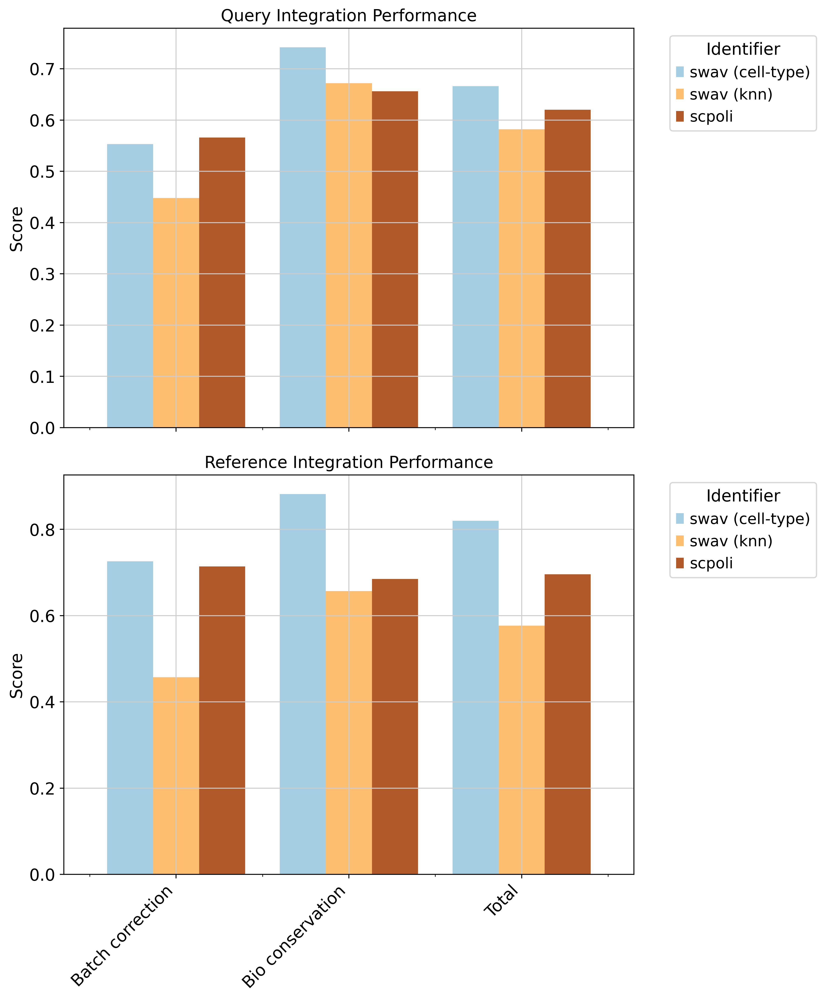

In [35]:
save_path = '/home/icb/fatemehs.hashemig/models/pbmc-immune/compare_bar.png'
plot_grouped_bar_two_stylers(ref, query, [0, 1, -1], ['swav (cell-type)', 'swav (knn)', 'scpoli'], save_path)

In [36]:
trainers[1].dump_path

'/home/icb/fatemehs.hashemig/models//pbmc-immune/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024_aug-knn8_ep0.02_model-v1'

In [37]:
for trainer in trainers:
    print(trainer.dump_path)


/home/icb/fatemehs.hashemig/models//pbmc-immune/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024_aug-cell_type8_ep0.02_model-v1
/home/icb/fatemehs.hashemig/models//pbmc-immune/swav-only_iloss0_closs0.0_num-prot-300_latent8-bs1024_aug-knn8_ep0.02_model-v1
/home/icb/fatemehs.hashemig/models//pbmc-immune/scpoli-pretrained_latent8_bs1024
/home/icb/fatemehs.hashemig/models//pbmc-immune/scpoli-both_latent8_bs1024
/home/icb/fatemehs.hashemig/models//pbmc-immune/scpoli-supervised_latent8_bs1024


## umaps

In [17]:
from PIL import Image
import os
from IPython.display import display

def load_and_show_image(image_path):
    """
    Load and display an image using PIL in a Jupyter Notebook.

    :param image_path: The file path to the image.
    """
    if os.path.exists(image_path):
        # Load the image
        img = Image.open(image_path)
        
        # Display the image in the notebook
        display(img)
    else:
        print(f"The file at path {image_path} does not exist.")

# Example usage:
# load_and_show_image('path/to/your/image.jpg')


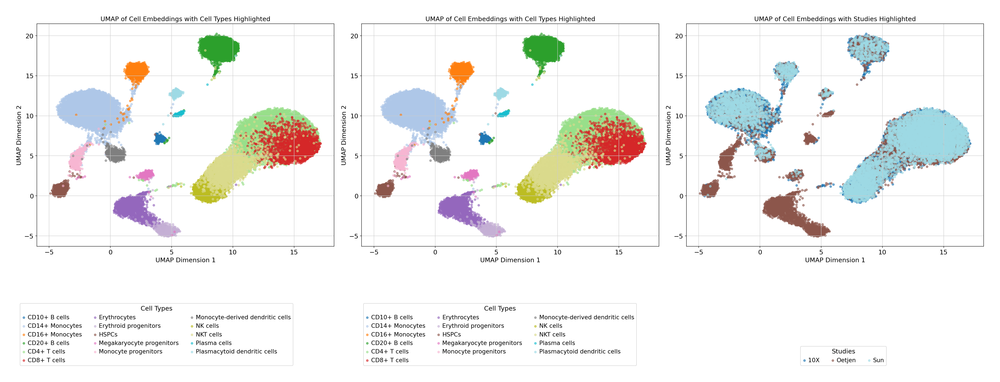

In [18]:
scpoli_ = trainers[-1]

path = scpoli_.dump_path
import os
ref = os.path.join(path, 'ref-umap.png')

load_and_show_image(ref)

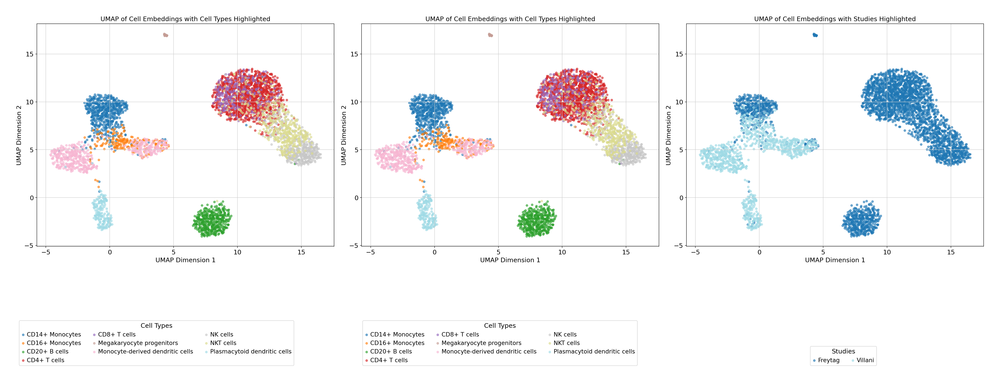

In [20]:
query = f'{path}/query-umap.png'
load_and_show_image(query)

In [41]:
from interpretable_ssl.trainers import adaptive_trainer
importlib.reload(adaptive_trainer)

from interpretable_ssl.trainers import swav
importlib.reload(swav)


<module 'interpretable_ssl.trainers.swav' from '/ictstr01/home/icb/fatemehs.hashemig/codes/interpretable-ssl/interpretable_ssl/trainers/swav.py'>

In [42]:
tr = swav.SwAV()
tr.setup()

loading data


/home/icb/fatemehs.hashemig/miniconda3/envs/lodechan_cloned/lib/python3.12/site-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator LabelEncoder from version 1.4.1.post1 when using version 1.5.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
INFO - 08/27/24 15:17:21 - 0:00:00 - ============ Initialized logger ============
INFO - 08/27/24 15:17:21 - 0:00:00 - all_latent: None
                                     augmentation_type: knn
                                     base_lr: 4.8
                                     batch_size: 512
                                     batch_size_version: 2
                                     cell_type_key: cell_type
                                     checkpoint_freq: 25
                                     condition_key: study
                   

Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


INFO - 08/27/24 15:13:51 - 0:00:00 - ============ Initialized logger ============
INFO - 08/27/24 15:13:51 - 0:00:00 - all_latent: None
                                     augmentation_type: knn
                                     base_lr: 4.8
                                     batch_size: 512
                                     batch_size_version: 2
                                     cell_type_key: cell_type
                                     checkpoint_freq: 25
                                     condition_key: study
                                     crops_for_assign: [0, 1]
                                     custom_cross_val: False
                                     cvae_loss_scaler: 0.0001
                                     cvae_reg: 0
                                     dataset: pbmc-immune
                                     dataset_id: pbmc-immune
                                     debug: False
                                     default_values: {'dataset

Embedding dictionary:
 	Num conditions: [3]
 	Embedding dim: [10]
Encoder Architecture:
	Input Layer in, out and cond: 4000 64 10
	Mean/Var Layer in/out: 64 8
Decoder Architecture:
	First Layer in, out and cond:  8 64 10
	Output Layer in/out:  64 4000 

swav model with l2n init


In [38]:
tr.pretraining_epochs = 1
tr.fine_tuning_epochs = 1

In [40]:
tr.ref

In [43]:


tr.train_semi_supervised()

AttributeError: 'Subset' object has no attribute 'adata'